In [5]:
import pathlib
import numpy as np
import scipy as sp
import pandas as pd
from matplotlib import pyplot as plt
import astropy as ast
from astropy import stats



import SessionTools.two_photon as st2p


plt.rcParams['pdf.fonttype']=42

%load_ext autoreload
%autoreload 2 


%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [17]:
basedir = pathlib.Path('/media/mplitt/SSD_storage/2P_scratch/R60D05LexA_jGCaMP7b_CsChrimsontdT_EL_hcKCR1')
sess_df = pd.read_csv(basedir / 'sessions.csv')
sess_df = sess_df.iloc[:-1]
print(sess_df.columns)
sess_df['fly_id'] = [row['date']+'_'+row['fly'] +'_' + row['condition'] for _, row in sess_df.iterrows()]
sess_df['mean offset'] = [np.nan for _, row in sess_df.iterrows()]
sess_df['offset var.'] = [np.nan for _, row in sess_df.iterrows()]
sess_df['mean vec. len'] = [np.nan for _, row in sess_df.iterrows()]


figfolder = pathlib.Path('/media/mplitt/SSD_storage/fig_scratch/R60D05LexA_jGCaMP7b_CsChrimsontdT_EL_hcKCR1')
figfolder.mkdir(parents=True, exist_ok=True)

sess_df = sess_df.loc[sess_df['usable']==1]

Index(['date', 'fly', 'sess', 'condition', 'scan_type', 'usable', 'notes'], dtype='object')


In [18]:
sess_df.head()

,date,fly,sess,condition,scan_type,usable,notes,fly_id,mean offset,offset var.,mean vec. len
0,19_11_2024,fly1,baseline-000,hckcr1,baseline,1.0,NaN,19_11_2024_fly1_hckcr1,NaN,NaN,NaN
1,19_11_2024,fly1,remap_0deg-001,hckcr1,remap_0deg,1.0,NaN,19_11_2024_fly1_hckcr1,NaN,NaN,NaN
2,19_11_2024,fly1,post_0deg-002,hckcr1,post_0deg,1.0,NaN,19_11_2024_fly1_hckcr1,NaN,NaN,NaN
3,19_11_2024,fly1,remap_180deg-003,hckcr1,remap_180deg,1.0,NaN,19_11_2024_fly1_hckcr1,NaN,NaN,NaN
4,19_11_2024,fly1,post_180deg-004,hckcr1,post_180deg,1.0,NaN,19_11_2024_fly1_hckcr1,NaN,NaN,NaN


In [19]:
sess_df.iloc[-1]

date                              10_12_2024
fly                                     fly2
sess                           post_0deg-006
condition                        uas_control
scan_type                          post_0deg
usable                                   1.0
notes                                    NaN
fly_id           10_12_2024_fly2_uas_control
mean offset                              NaN
offset var.                              NaN
mean vec. len                            NaN
Name: 134, dtype: object

In [20]:
for index,row in sess_df.iterrows():
    outdir = pathlib.PurePath( basedir / row['condition'] / row['date'] / row['fly'] / row['sess'] / 'preprocess.pkl')
    pp = st2p.preprocessing.EBImagingSession.from_file(outdir)
    dff = pp.calculate_zscored_F('rois', exp_detrend=True, zscore=False, background_ts='background')[-1,:,:] -1
    dff_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(dff, 2, axis=-1),1,axis=1, mode='wrap')
    
    heading = np.angle(np.exp(1j*(-1*pp.voltage_recording_aligned[' Heading'].to_numpy()-np.pi)))
    h_mask = np.abs(heading)<2.5
        
        
    x_f,y_f = st2p.utilities.pol2cart(dff_sm ,np.linspace(-np.pi,np.pi,num=dff_sm.shape[0])[:,np.newaxis])
    rho,phi = st2p.utilities.cart2pol(x_f.mean(axis=0), y_f.mean(axis=0))

    _,offset = st2p.utilities.cart2pol(*st2p.utilities.pol2cart(np.ones(heading.shape),phi-heading))
    # print(offset.shape)
    
    
    x_o, y_o = st2p.utilities.pol2cart(np.ones(heading[h_mask].shape), offset[h_mask])
    r, offset_mu = st2p.utilities.cart2pol(x_o.mean(), y_o.mean())
    
    sess_df.loc[index, 'mean offset'] = offset_mu
    sess_df.loc[index, 'mean vec. len'] = r
    sess_df.loc[index, 'offset var.'] = sp.stats.circvar(offset[h_mask])

In [21]:
hckcr1_sess_df = sess_df[sess_df['condition']=='hckcr1']
flies = hckcr1_sess_df['fly_id'].unique()
print(flies.shape)

hckcr1_data = {'fly': [],
              'baseline_mu':[],
              'baseline_var':[],
              'baseline_r':[],
              '0deg_mu':[],
              '0deg_var':[],
              '0deg_r': [],
              '180deg_mu':[],
              '180deg_var':[],
              '180deg_r':[],
             }

for fly in flies:
    _df = hckcr1_sess_df['fly_id']==fly
    hckcr1_data['fly'].append(fly)
    
    baseline = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='baseline')]
    hckcr1_data['baseline_mu'].append(baseline['mean offset'].mean())
    hckcr1_data['baseline_var'].append(baseline['offset var.'].mean())
    hckcr1_data['baseline_r'].append(baseline['mean vec. len'].mean())
    
    deg0 = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='post_0deg')]
    hckcr1_data['0deg_mu'].append(deg0['mean offset'].mean())
    hckcr1_data['0deg_var'].append(deg0['offset var.'].mean())
    hckcr1_data['0deg_r'].append(deg0['mean vec. len'].mean())
    
    deg180 = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='post_180deg')]
    hckcr1_data['180deg_mu'].append(deg180['mean offset'].mean())
    hckcr1_data['180deg_var'].append(deg180['offset var.'].mean())
    hckcr1_data['180deg_r'].append(deg180['mean vec. len'].mean())

hckcr1_data = pd.DataFrame(hckcr1_data)
hckcr1_data.head()

(13,)


,fly,baseline_mu,baseline_var,baseline_r,0deg_mu,0deg_var,0deg_r,180deg_mu,180deg_var,180deg_r
0,19_11_2024_fly1_hckcr1,0.124854,0.816503,0.183497,-1.810819,0.760510,0.239490,-1.049754,0.680000,0.320000
1,19_11_2024_fly2_hckcr1,2.947030,0.592921,0.407079,-2.661341,0.638122,0.361878,3.064002,0.450140,0.549860
2,23_11_2024_fly1_hckcr1,-0.283092,0.790205,0.209795,-0.399983,0.639686,0.360314,-0.805381,0.714499,0.285501
3,25_11_2024_fly1_hckcr1,0.017768,0.733252,0.266748,-0.586786,0.671699,0.328301,-0.182021,0.686893,0.313107
4,25_11_2024_fly2_hckcr1,1.975109,0.524178,0.475822,2.642891,0.595498,0.404502,2.476433,0.683126,0.316874


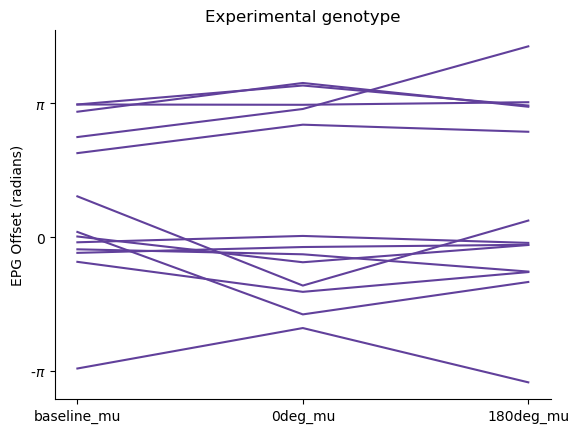

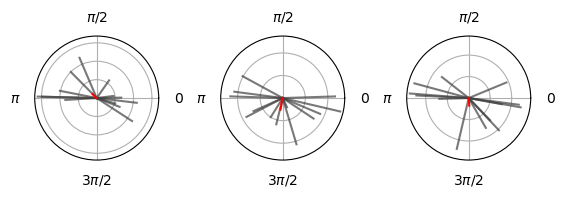

In [23]:
fig, ax= plt.subplots()

for index,row in hckcr1_data.iterrows():
    baseline = row['baseline_mu']
    mu0 = np.array([row['0deg_mu'], row['0deg_mu']+2*np.pi, row['0deg_mu']-2*np.pi])
    mu0 = mu0[np.argmin(np.abs(baseline-mu0))]
    mu180 = np.array([row['180deg_mu'], row['180deg_mu']+2*np.pi, row['180deg_mu']-2*np.pi])
    mu180 = mu180[np.argmin(np.abs(baseline-mu180))]
    ax.plot([baseline, mu0, mu180], color=plt.cm.Purples(.8))

# _ = ax.plot(hckcr1_data[['baseline_mu','0deg_mu','180deg_mu']].T, color=plt.cm.Purples(.8))
ax.set_xticks([0,1,2], labels = ['baseline_mu','0deg_mu','180deg_mu'])
ax.set_ylabel('EPG Offset (radians)')
ax.set_title('Experimental genotype')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_yticks([-np.pi, 0, np.pi], labels=[r'-$\pi$', 0, r'$\pi$'])
fig.savefig(figfolder / 'experimental_summary.pdf')

fig, ax = plt.subplots(1,3,subplot_kw={'projection': 'polar'})
fig.subplots_adjust(wspace=.5)
for index,row in hckcr1_data.iterrows():
    ax[0].plot(row['baseline_mu']*np.ones([2,]), [0, row['baseline_r']], color=plt.cm.Greys(.8), alpha=.7)
    ax[1].plot(row['0deg_mu']*np.ones([2,]), [0, row['0deg_r']], color=plt.cm.Greys(.8), alpha=.7)
    ax[2].plot(row['180deg_mu']*np.ones([2,]), [0, row['180deg_r']], color=plt.cm.Greys(.8), alpha=.7)


    
for a in ax:
    a.set_xticks([0, np.pi/2, np.pi, 3*np.pi/2], ['0', r'$\pi$/2', r'$\pi$', r'3$\pi$/2'])
    a.set_yticks([0,.2,.4,.6,.8],['','','','',''])
    
v = hckcr1_data['baseline_r']*(np.cos(hckcr1_data['baseline_mu']) + 1j*np.sin(hckcr1_data['baseline_mu']))
ax[0].plot(np.angle(v.mean())*np.ones([2,]), np.absolute(v.mean())*np.array([0,1]), color='red')
v = hckcr1_data['0deg_r']*(np.cos(hckcr1_data['0deg_mu']) + 1j*np.sin(hckcr1_data['0deg_mu']))
ax[1].plot(np.angle(v.mean())*np.ones([2,]), np.absolute(v.mean())*np.array([0,1]), color='red')
v = hckcr1_data['180deg_r']*(np.cos(hckcr1_data['180deg_mu']) + 1j*np.sin(hckcr1_data['180deg_mu']))
ax[2].plot(np.angle(v.mean())*np.ones([2,]), np.absolute(v.mean())*np.array([0,1]), color='red')

fig.savefig(figfolder / 'experimental_summary_polar.pdf')

In [12]:
uas_ctrl_sess_df = sess_df[sess_df['condition']=='uas_control']
flies = uas_ctrl_sess_df['fly_id'].unique()
print(flies.shape)

uas_ctrl_data = {'fly': [],
              'baseline_mu':[],
              'baseline_var':[],
              'baseline_r':[],
              '0deg_mu':[],
              '0deg_var':[],
              '0deg_r': [],
              '180deg_mu':[],
              '180deg_var':[],
              '180deg_r':[],
             }

for fly in flies:
    _df = uas_ctrl_sess_df['fly_id']==fly
    uas_ctrl_data['fly'].append(fly)
    
    baseline = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='baseline')]
    uas_ctrl_data['baseline_mu'].append(baseline['mean offset'].mean())
    uas_ctrl_data['baseline_var'].append(baseline['offset var.'].mean())
    uas_ctrl_data['baseline_r'].append(baseline['mean vec. len'].mean())
    
    deg0 = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='post_0deg')]
    uas_ctrl_data['0deg_mu'].append(deg0['mean offset'].mean())
    uas_ctrl_data['0deg_var'].append(deg0['offset var.'].mean())
    uas_ctrl_data['0deg_r'].append(deg0['mean vec. len'].mean())
    
    deg180 = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='post_180deg')]
    uas_ctrl_data['180deg_mu'].append(deg180['mean offset'].mean())
    uas_ctrl_data['180deg_var'].append(deg180['offset var.'].mean())
    uas_ctrl_data['180deg_r'].append(deg180['mean vec. len'].mean())

uas_ctrl_data = pd.DataFrame(uas_ctrl_data)
uas_ctrl_data.head()

(14,)


,fly,baseline_mu,baseline_var,baseline_r,0deg_mu,0deg_var,0deg_r,180deg_mu,180deg_var,180deg_r
0,23_11_2024_fly1_uas_control,-0.443241,0.278113,0.721887,-0.277986,0.288827,0.711173,2.998344,0.539414,0.460586
1,25_11_2024_fly1_uas_control,1.518249,0.702609,0.297391,1.139478,0.640584,0.359416,2.550839,0.682093,0.317907
2,25_11_2024_fly2_uas_control,0.715075,0.576603,0.423397,0.447101,0.640065,0.359935,1.071578,0.590976,0.409024
3,27_11_2024_fly1_uas_control,-1.597113,0.740457,0.259543,-1.114031,0.756166,0.243834,-2.536823,0.658749,0.341251
4,27_11_2024_fly2_uas_control,-0.805674,0.665484,0.334516,-0.860641,0.652712,0.347288,3.027909,0.681106,0.318894


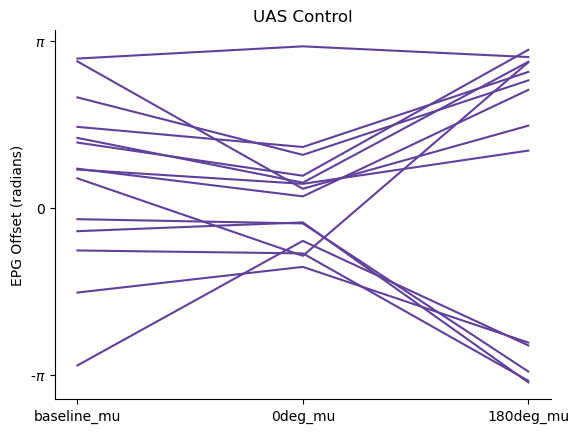

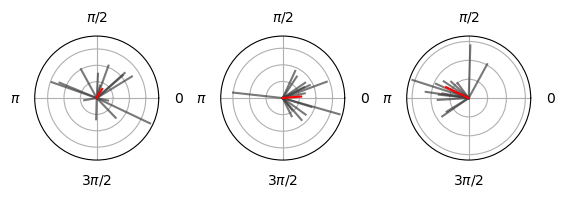

In [24]:
fig, ax= plt.subplots()

for index,row in uas_ctrl_data.iterrows():
    baseline = row['baseline_mu']
    mu0 = np.array([row['0deg_mu'], row['0deg_mu']+2*np.pi, row['0deg_mu']-2*np.pi])
    mu0 = mu0[np.argmin(np.abs(baseline-mu0))]
    mu180 = np.array([row['180deg_mu'], row['180deg_mu']+2*np.pi, row['180deg_mu']-2*np.pi])
    mu180 = mu180[np.argmin(np.abs(baseline-mu180))]
    ax.plot([baseline, mu0, mu180], color=plt.cm.Purples(.8))


# _ = ax.plot(uas_ctrl_data[['baseline_mu','0deg_mu','180deg_mu']].T, color=plt.cm.Purples(.8))
ax.set_xticks([0,1,2], labels = ['baseline_mu','0deg_mu','180deg_mu'])
ax.set_ylabel('EPG Offset (radians)')
ax.set_title('UAS Control')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_yticks([-np.pi, 0, np.pi], labels=[r'-$\pi$', 0, r'$\pi$'])
fig.savefig(figfolder / 'uas_control_summary.pdf')

fig, ax = plt.subplots(1,3,subplot_kw={'projection': 'polar'})
fig.subplots_adjust(wspace=.5)
for index,row in uas_ctrl_data.iterrows():
    ax[0].plot(row['baseline_mu']*np.ones([2,]), [0, row['baseline_r']], color=plt.cm.Greys(.8), alpha=.7)
    ax[1].plot(row['0deg_mu']*np.ones([2,]), [0, row['0deg_r']], color=plt.cm.Greys(.8), alpha=.7)
    ax[2].plot(row['180deg_mu']*np.ones([2,]), [0, row['180deg_r']], color=plt.cm.Greys(.8), alpha=.7)


    
for a in ax:
    a.set_xticks([0, np.pi/2, np.pi, 3*np.pi/2], ['0', r'$\pi$/2', r'$\pi$', r'3$\pi$/2'])
    a.set_yticks([0,.2,.4,.6,.8],['','','','',''])
    
v = uas_ctrl_data['baseline_r']*(np.cos(uas_ctrl_data['baseline_mu']) + 1j*np.sin(uas_ctrl_data['baseline_mu']))
ax[0].plot(np.angle(v.mean())*np.ones([2,]), np.absolute(v.mean())*np.array([0,1]), color='red')
v = uas_ctrl_data['0deg_r']*(np.cos(uas_ctrl_data['0deg_mu']) + 1j*np.sin(uas_ctrl_data['0deg_mu']))
ax[1].plot(np.angle(v.mean())*np.ones([2,]), np.absolute(v.mean())*np.array([0,1]), color='red')
v = uas_ctrl_data['180deg_r']*(np.cos(uas_ctrl_data['180deg_mu']) + 1j*np.sin(uas_ctrl_data['180deg_mu']))
ax[2].plot(np.angle(v.mean())*np.ones([2,]), np.absolute(v.mean())*np.array([0,1]), color='red')

fig.savefig(figfolder / 'uas_control_summary_polar.pdf')

In [25]:
def get_ts(pp, coef = 0):
    y_epg = pp.timeseries['rois_z']
    heading = -1*pp.voltage_recording_aligned[' Heading'].to_numpy()
    bar_vis_mask = np.abs(heading)>1.5
   
    y_epg_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_epg-1, 2, axis=-1),1,axis=1, mode='wrap')
    
    
    n_rois = y_epg.shape[1]
    x_f,y_f = st2p.utilities.pol2cart(y_epg[-1,:,:] ,np.linspace(-np.pi,np.pi,num=n_rois)[:,np.newaxis])
    rho_epg, phi_epg = st2p.utilities.cart2pol(x_f.mean(axis=0), y_f.mean(axis=0))


    _,offset_epg = st2p.utilities.cart2pol(*st2p.utilities.pol2cart(np.ones(heading.shape),phi_epg-heading))

    
    return {'heading': heading,
            'bar_vis_mask': bar_vis_mask,
            'y_epg': y_epg,
            'y_epg_sm': y_epg_sm,
            'rho_epg': rho_epg,
            'phi_epg': phi_epg,
            'offset_epg': offset_epg}


def align_to_heading(ts):
    heading_bins = np.linspace(-np.pi, np.pi, num=17)
    heading_dig = np.digitize(ts['heading'], heading_bins)-1

    y_h_aligned = np.zeros([1,*ts['y_epg'].shape[1:]])
    for ind in range(ts['heading'].shape[0]):
        y_h_aligned[-1,:,ind] = np.roll(ts['y_epg'][-1,:,ind], -heading_dig[ind])
        # y_h_aligned[1,:,ind] = np.roll(ts['y_epg'][1,:,ind], -heading_dig[ind])
       
        
    y_h_aligned_z = np.zeros((1,16,16))
    for b in range(16):
        mask = heading_dig==b
        y_h_aligned_z[:,:,b] = y_h_aligned[:,:,mask].mean(axis=-1)
    
    
    return heading_bins, y_h_aligned, y_h_aligned_z


19_11_2024_fly1_hckcr1
19_11_2024_fly2_hckcr1
23_11_2024_fly1_hckcr1
25_11_2024_fly1_hckcr1
25_11_2024_fly2_hckcr1
27_11_2024_fly1_hckcr1
06_12_2024_fly1_hckcr1
06_12_2024_fly2_hckcr1
06_12_2024_fly3_hckcr1
08_12_2024_fly2_hckcr1
08_12_2024_fly3_hckcr1


/tmp/ipykernel_1180281/3682927799.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(3,2,figsize=(15,6),sharey=True)


09_12_2024_fly2_hckcr1
09_12_2024_fly3_hckcr1
23_11_2024_fly1_uas_control
25_11_2024_fly1_uas_control
25_11_2024_fly2_uas_control
27_11_2024_fly1_uas_control
27_11_2024_fly2_uas_control
05_12_2024_fly1_uas_control
05_12_2024_fly2_uas_control
06_12_2024_fly1_uas_control
06_12_2024_fly2_uas_control
06_12_2024_fly3_uas_control
09_12_2024_fly1_uas_control
09_12_2024_fly2_uas_control
10_12_2024_fly1_uas_control
10_12_2024_fly2_uas_control


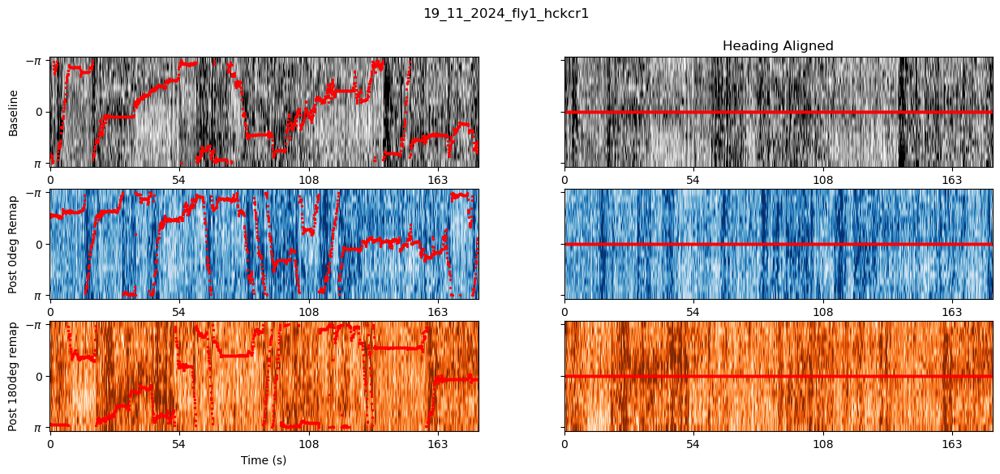

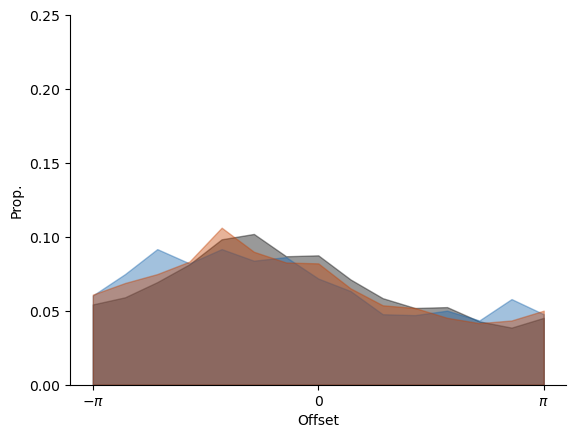

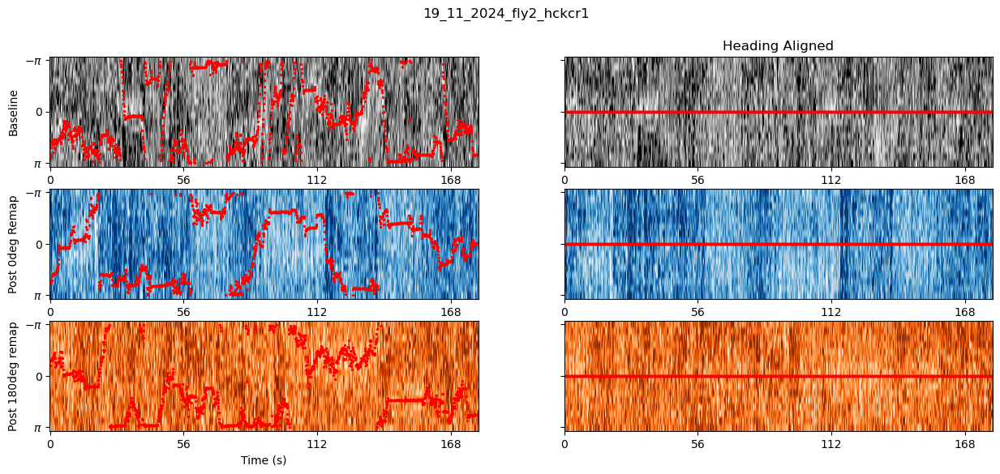

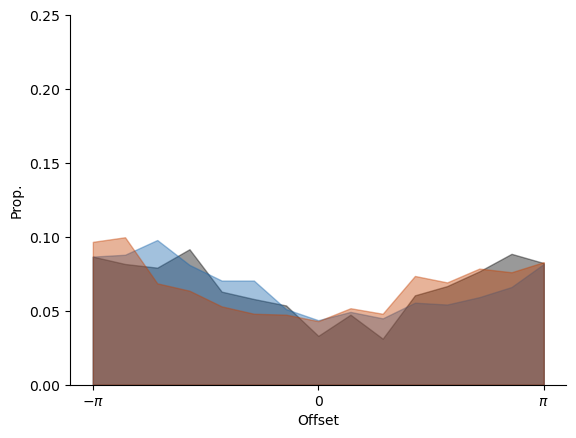

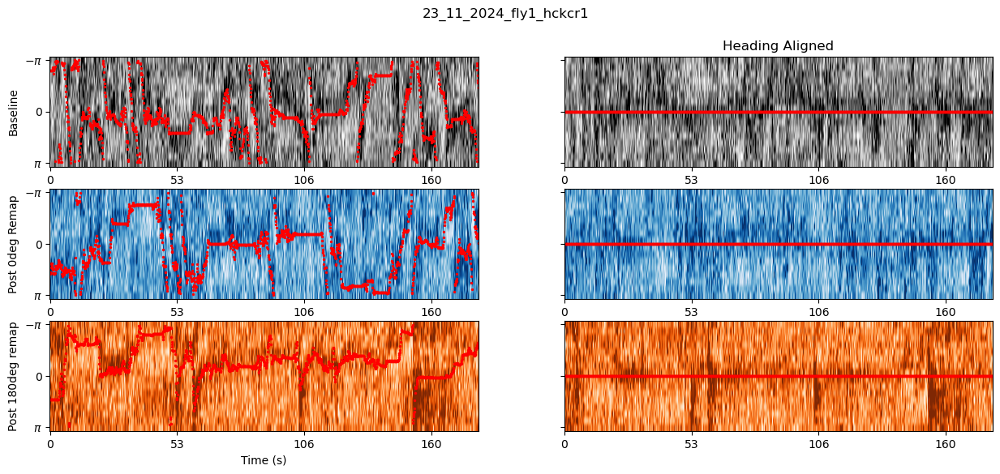

...

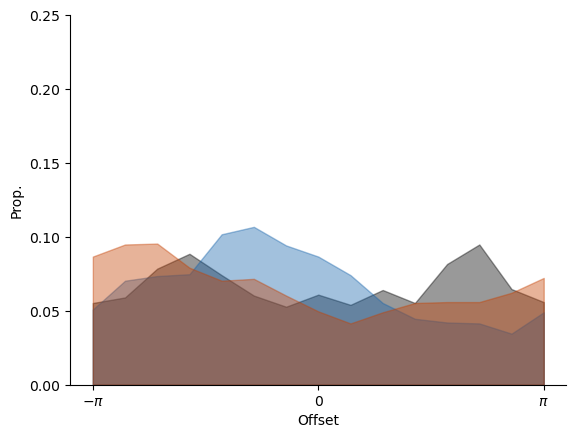

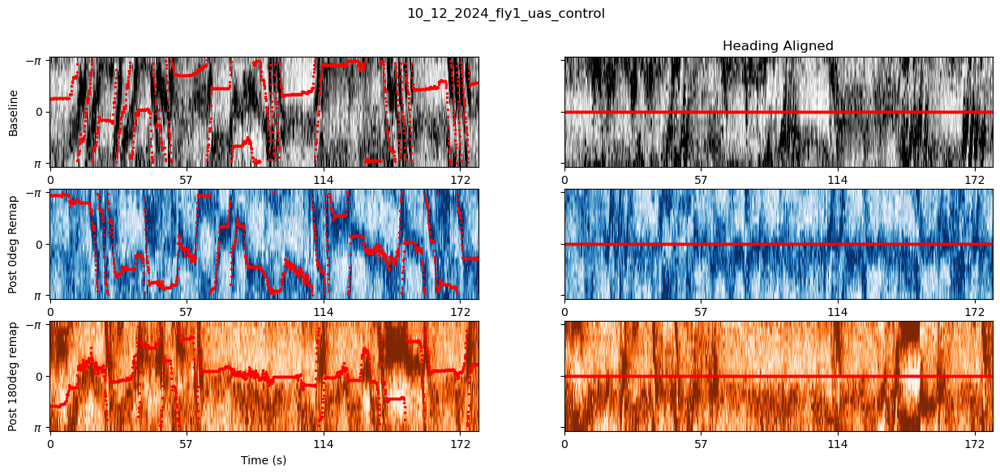

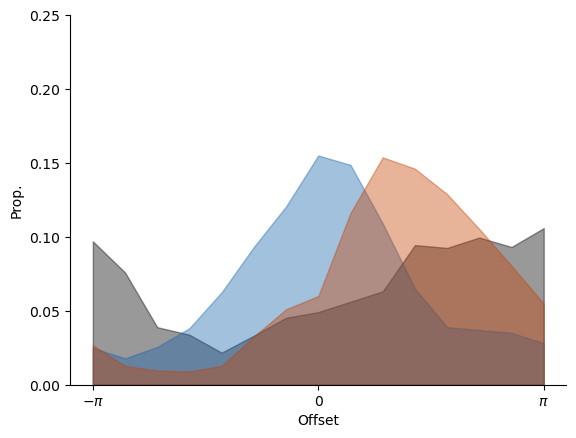

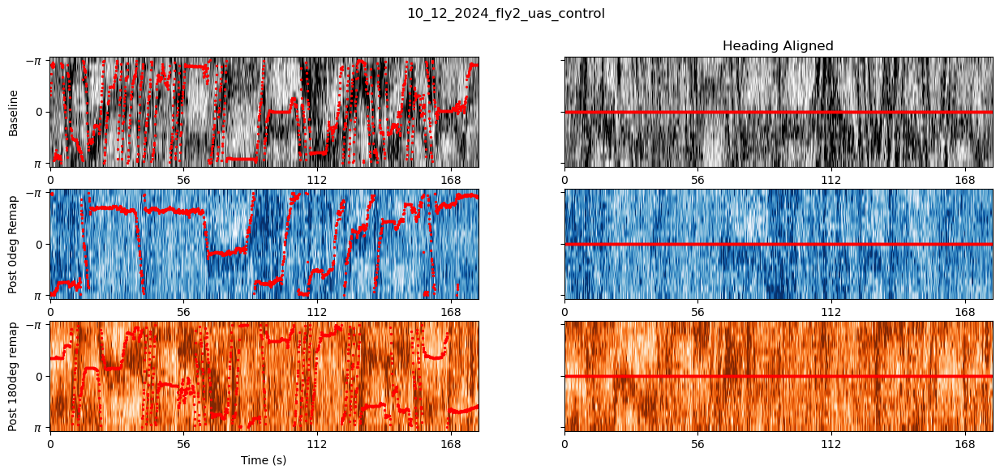

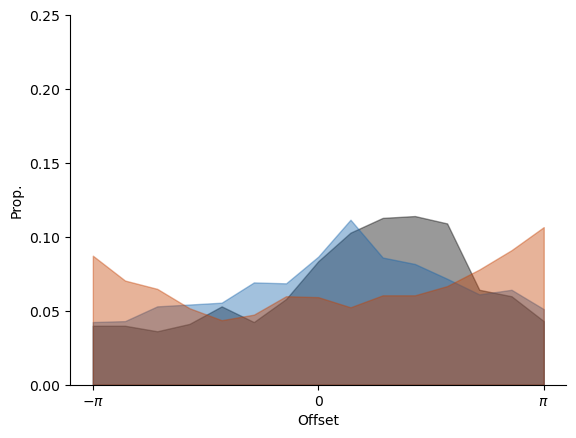

In [31]:
# remap_sess_df = sess_df[sess_df['condition']=='remap']

eg_folder = figfolder / "example_sessions"
eg_folder.mkdir(parents=True, exist_ok=True)
flies = sess_df['fly_id'].unique()


bins = np.arange(16)
edges = np.linspace(-np.pi, np.pi, num=16)
window = slice(0,10000)
centers = (edges[:-1]+edges[1:])/2
    
for fly in flies:
    print(fly)
    _df = sess_df['fly_id']==fly
    # remap_data['fly'].append(fly)
    
    fig, ax = plt.subplots(3,2,figsize=(15,6),sharey=True)
    fig.suptitle(fly)
    fig_hist, ax_hist = plt.subplots()

    ##
    baseline = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='baseline')].iloc[0]
    # print(baseline.iloc[0])
    outdir = pathlib.PurePath( basedir / baseline['condition'] / baseline['date'] / baseline['fly'] / baseline['sess'] / 'preprocess.pkl')
    pp = st2p.preprocessing.EBImagingSession.from_file(outdir)
    ts = get_ts(pp,coef=0)
    
    h = ax[0,0].imshow(ts['y_epg'][-1,:,window]-1,aspect='auto',cmap='Greys', 
                     vmin=np.percentile(ts['y_epg'][-1,:,:]-1,5), 
                     vmax=np.percentile(ts['y_epg'][-1,:,:]-1,85))
    
    heading = 15*(np.angle(np.exp(1j*(ts['heading']-np.pi)))+np.pi)/2/np.pi
    t = np.arange(ts['heading'].shape[-1])
    ax[0,0].scatter(t, heading, s=2, color='red')
    
    # time = 
    time = np.array(pp.metadata['frame_times']).mean(axis=-1)
    ax[0,0].set_xticks(t[::500],labels=[int(_t) for _t in time[::500]])
    ax[0,0].set_yticks([0, 7.5, 15], labels=[r'$-\pi$', 0, r'$\pi$'])
    
    ax[0,0].set_ylabel('Baseline')
    
    heading_bins, y_h_aligned, y_h_aligned_z = align_to_heading(ts)
    h = ax[0,1].imshow(y_h_aligned[-1,:,window]-1, aspect='auto',cmap='Greys', 
                 vmin=np.percentile(ts['y_epg'][-1,:,:]-1,5), 
                 vmax=np.percentile(ts['y_epg'][-1,:,:]-1,85))
    
    ax[0,1].set_xticks(t[::500],labels=[int(_t) for _t in time[::500]])
    ax[0,1].scatter(t, 7.5*np.ones_like(t), s=2, color='red')
    ax[0,1].set_title('Heading Aligned')
    
    hist, _ = np.histogram(ts['offset_epg'], bins = np.linspace(-np.pi,np.pi,num=16))
    hist = np.roll(hist,-8)
    ax_hist.fill_between(centers, hist/hist.sum(), alpha=.4, color='black')
    ax_hist.set_xticks([centers[0], 0, centers[-1]], labels=[r'$-\pi$', 0, r'$\pi$'])
    # ax_hist.set_xlim([-1,16])
    ##
    
    ##
    post0 = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='post_0deg')].iloc[0]
    outdir = pathlib.PurePath( basedir / post0['condition'] / post0['date'] / post0['fly'] / post0['sess'] / 'preprocess.pkl')
    pp = st2p.preprocessing.EBImagingSession.from_file(outdir)
    ts = get_ts(pp,coef=0)
    
    h = ax[1,0].imshow(ts['y_epg'][-1,:,window]-1,aspect='auto',cmap='Blues', 
                     vmin=np.percentile(ts['y_epg'][-1,:,:]-1,5), 
                     vmax=np.percentile(ts['y_epg'][-1,:,:]-1,85))
    
    heading = 15*(np.angle(np.exp(1j*(ts['heading']-np.pi)))+np.pi)/2/np.pi
    t = np.arange(ts['heading'].shape[-1])
    ax[1,0].scatter(t, heading, s=2, color='red')
    
    time = np.array(pp.metadata['frame_times']).mean(axis=-1)
    ax[1,0].set_xticks(t[::500],labels=[int(_t) for _t in time[::500]])
    
    heading_bins, y_h_aligned, y_h_aligned_z = align_to_heading(ts)
    h = ax[1,1].imshow(y_h_aligned[-1,:,window]-1, aspect='auto',cmap='Blues', 
                 vmin=np.percentile(ts['y_epg'][-1,:,:]-1,5), 
                 vmax=np.percentile(ts['y_epg'][-1,:,:]-1,85))
    
    time = np.array(pp.metadata['frame_times']).mean(axis=-1)
    ax[1,1].set_xticks(t[::500],labels=[int(_t) for _t in time[::500]])
    ax[1,1].scatter(t, 7.5*np.ones_like(t), s=2, color='red')
    
    ax[1,0].set_ylabel('Post 0deg Remap')
    
    hist, _ = np.histogram(ts['offset_epg'], bins = np.linspace(-np.pi,np.pi,num=16))
    hist = np.roll(hist,-8)
    ax_hist.fill_between(centers, hist/hist.sum(), alpha=.4, color=plt.cm.Blues(.8))
    ##
    
    ##
    post180 = sess_df.loc[(sess_df['fly_id']==fly) & (sess_df['scan_type']=='post_180deg')].iloc[0]
    outdir = pathlib.PurePath( basedir / post180['condition'] / post180['date'] / post180['fly'] / post180['sess'] / 'preprocess.pkl')
    pp = st2p.preprocessing.EBImagingSession.from_file(outdir)
    ts = get_ts(pp,coef=0)
    
    
    h = ax[2,0].imshow(ts['y_epg'][-1,:,window]-1,aspect='auto',cmap='Oranges', 
                     vmin=np.percentile(ts['y_epg'][-1,:,:]-1,5), 
                     vmax=np.percentile(ts['y_epg'][-1,:,:]-1,85))
    
    heading = 15*(np.angle(np.exp(1j*(ts['heading']-np.pi)))+np.pi)/2/np.pi
    t = np.arange(ts['heading'].shape[-1])
    ax[2,0].scatter(t, heading, s=2, color='red')
    time = np.array(pp.metadata['frame_times']).mean(axis=-1)
    ax[2,0].set_xticks(t[::500],labels=[int(_t) for _t in time[::500]])
    
    heading_bins, y_h_aligned, y_h_aligned_z = align_to_heading(ts)
    h = ax[2,1].imshow(y_h_aligned[-1,:,window]-1, aspect='auto',cmap='Oranges', 
                 vmin=np.percentile(ts['y_epg'][-1,:,:]-1,5), 
                 vmax=np.percentile(ts['y_epg'][-1,:,:]-1,85))
    time = np.array(pp.metadata['frame_times']).mean(axis=-1)
    ax[2,1].set_xticks(t[::500],labels=[int(_t) for _t in time[::500]])
    ax[2,1].scatter(t, 7.5*np.ones_like(t), s=2, color='red')
    
    ax[2,0].set_ylabel('Post 180deg remap')
    ax[2,0].set_xlabel('Time (s)')
    
    hist, _ = np.histogram(ts['offset_epg'], bins = np.linspace(-np.pi,np.pi,num=16))
    hist = np.roll(hist,-8)
    ax_hist.fill_between(centers, hist/hist.sum(), alpha=.4, color=plt.cm.Oranges(.8))
    ##
    
    ax_hist.set_ylim([0,.25])
    ax_hist.spines['top'].set_visible(False)
    ax_hist.spines['right'].set_visible(False)
    ax_hist.set_xlabel('Offset')
    ax_hist.set_ylabel('Prop.')
    
    
    fig.savefig(eg_folder / f"{fly}_heatmaps.pdf")
    fig_hist.savefig(eg_folder / f"{fly}_hist.pdf")